# Spatio-Temporal Modeling with Convolutional Neural Networks

In this notebook, I will attempt to build a CNN model that will predict drought levels for all locations across the contiguous United States based on past data points. Each data point in the weekly time series consists of a rectangular grid where each point on the grid has an associated numerical value reflecting drought levels.

## Second Model
### X: 4 preceding data points from across year 
### 1 year, 6 months, 5 weeks, 1 week prior
### 50 epochs

In [1]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt

np.random.seed(42)

from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, Conv3D, MaxPooling3D
from keras.utils import np_utils

%matplotlib inline

Using TensorFlow backend.


In [2]:
drought_array = pd.read_csv("./data/drought_simplified_array.csv")

In [3]:
drought_array.drop(columns="Unnamed: 0", inplace=True)

In [4]:
drt = pd.read_csv("./data/drought_data_combined.csv")

drt.set_index("Date", inplace=True)

drt.index = pd.to_datetime(drt.index)

In [5]:
latitudes = [0.25*i for i in list(range(96, 201))]
latitudes.reverse()

longitudes = [0.25*i for i in list(range(-500, -263))]

dates = list(drt.index.unique().sort_values())

In [6]:
drought_3D = drought_array.values.reshape(len(dates), len(latitudes), len(longitudes))

In [7]:
drought_3D.shape

(1009, 105, 237)

In [8]:
drought_3D[52:].shape

(957, 105, 237)

I'll try a model in which the X variable is 4 dates that are scattered throughout the prior year.

In [9]:
X = np.array([])
for i in range(drought_3D[:-52].shape[0]):
    data_point = np.array([drought_3D[i], drought_3D[i+26], drought_3D[i+48], drought_3D[i+52]])
    X = np.append(X, data_point)

In [10]:
X.shape

(95259780,)

In [11]:
X_matrix = X.reshape(957, 4, 105, 237, 1)

In [12]:
X_matrix.shape

(957, 4, 105, 237, 1)

In [13]:
105*237

24885

In [14]:
Y = drought_3D[52:].reshape(957, 24_885)

In [15]:
Y.shape

(957, 24885)

In [16]:
X_train = X_matrix[:700]
X_test  = X_matrix[700:]
Y_train = Y[:700]
Y_test  = Y[700:]

In [17]:
X_train.shape

(700, 4, 105, 237, 1)

In [18]:
X_test.shape

(257, 4, 105, 237, 1)

In [19]:
Y_train.shape

(700, 24885)

In [20]:
Y_test.shape

(257, 24885)

I found the function below from the following stack overflow page: https://stackoverflow.com/questions/45250100/kerasregressor-coefficient-of-determination-r2-score

It needs to be modified so that it cycles through the time series for each pixel out of the 24,885. I will work on correcting this moving forward. I have not been able to figure this out, so as it is now, the r2 scores that are displayed are erroneous. I'm not sure what they represent. The MSE and MAE metrics should be correct.

In [21]:
def r2_score(y_true, y_pred):
    from keras import backend as K
    SS_res =  K.sum(K.square( y_true-y_pred ))
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) )
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

## CNN Model

In [22]:
cnn_model = Sequential()

In [23]:
cnn_model.add(Conv3D(filters = 6,                # number of filters
                     kernel_size = (2, 9, 9),    # height/width of filter, could increase the 5,5
                     activation='relu',          # activation function 
                     input_shape=(4,105,237,1))) # shape of input

In [24]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4))) # dimensions of region of pooling

In [25]:
cnn_model.add(Conv3D(16,
                     kernel_size=(2, 9, 9),
                     activation='relu'))

In [26]:
cnn_model.add(MaxPooling3D(pool_size=(1,4,4)))

In [27]:
cnn_model.add(Flatten())

In [28]:
cnn_model.add(Dense(128, activation='relu'))

In [29]:
cnn_model.add(Dense(24_885, activation='linear'))

In [30]:
cnn_model.compile(loss='mean_squared_error',
                  optimizer='adam',
                  metrics=['mse', "mae", r2_score])

In [31]:
history = cnn_model.fit(X_train,
                        Y_train,
                        batch_size=256,
                        validation_data=(X_test, Y_test),
                        epochs=50,
                        verbose=1)

Train on 700 samples, validate on 257 samples
Epoch 1/50
700/700 [==============================] - 190s 272ms/step - loss: 2.4817 - mean_squared_error: 2.4817 - mean_absolute_error: 0.7339 - r2_score: -0.2320 - val_loss: 1.4661 - val_mean_squared_error: 1.4661 - val_mean_absolute_error: 0.5346 - val_r2_score: -0.0296
Epoch 2/50
700/700 [==============================] - 186s 265ms/step - loss: 1.8277 - mean_squared_error: 1.8277 - mean_absolute_error: 0.7530 - r2_score: 0.0945 - val_loss: 1.1479 - val_mean_squared_error: 1.1479 - val_mean_absolute_error: 0.6726 - val_r2_score: 0.1759
Epoch 3/50
700/700 [==============================] - 185s 265ms/step - loss: 1.1946 - mean_squared_error: 1.1946 - mean_absolute_error: 0.6645 - r2_score: 0.4063 - val_loss: 1.0559 - val_mean_squared_error: 1.0559 - val_mean_absolute_error: 0.5287 - val_r2_score: 0.2518
Epoch 4/50
700/700 [==============================] - 186s 266ms/step - loss: 1.1301 - mean_squared_error: 1.1301 - mean_absolute_error:

Epoch 31/50
700/700 [==============================] - 185s 264ms/step - loss: 0.1918 - mean_squared_error: 0.1918 - mean_absolute_error: 0.2503 - r2_score: 0.9046 - val_loss: 0.4960 - val_mean_squared_error: 0.4960 - val_mean_absolute_error: 0.3951 - val_r2_score: 0.6489
Epoch 32/50
700/700 [==============================] - 185s 265ms/step - loss: 0.1851 - mean_squared_error: 0.1851 - mean_absolute_error: 0.2466 - r2_score: 0.9080 - val_loss: 0.4850 - val_mean_squared_error: 0.4850 - val_mean_absolute_error: 0.3899 - val_r2_score: 0.6567
Epoch 33/50
700/700 [==============================] - 185s 264ms/step - loss: 0.1786 - mean_squared_error: 0.1786 - mean_absolute_error: 0.2419 - r2_score: 0.9113 - val_loss: 0.4764 - val_mean_squared_error: 0.4764 - val_mean_absolute_error: 0.3875 - val_r2_score: 0.6627
Epoch 34/50
700/700 [==============================] - 185s 264ms/step - loss: 0.1725 - mean_squared_error: 0.1725 - mean_absolute_error: 0.2383 - r2_score: 0.9140 - val_loss: 0.473

In [32]:
cnn_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 3, 97, 229, 6)     978       
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 3, 24, 57, 6)      0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 2, 16, 49, 16)     15568     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 2, 4, 12, 16)      0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1536)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               196736    
_________________________________________________________________
dense_2 (Dense)              (None, 24885)             3210165   
Total para

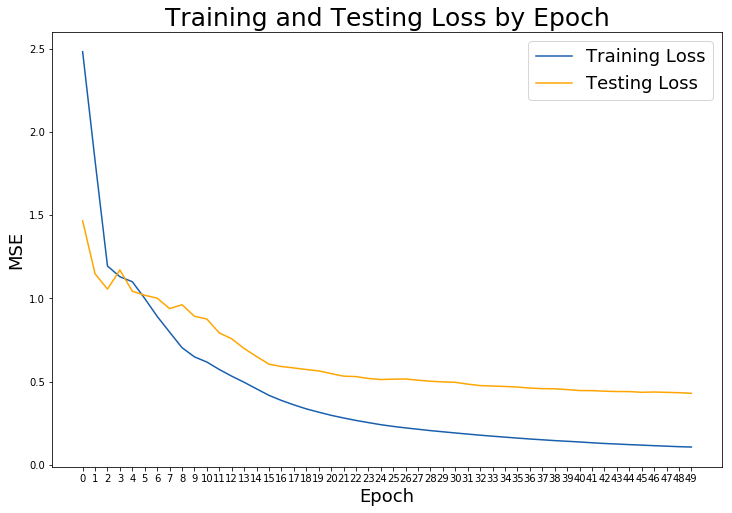

In [34]:
# Check out our train loss and test loss over epochs.
train_loss = history.history['loss']
test_loss = history.history['val_loss']

# Set figure size.
plt.figure(figsize=(12, 8))

# Generate line plot of training, testing loss over epochs.
plt.plot(train_loss, label='Training Loss', color='#185fad')
plt.plot(test_loss, label='Testing Loss', color='orange')

# Set title
plt.title('Training and Testing Loss by Epoch', fontsize = 25)
plt.xlabel('Epoch', fontsize = 18)
plt.ylabel('MSE', fontsize = 18)
plt.xticks(list(range(50)))

plt.legend(fontsize = 18);


In [35]:
# Evaluate model on test data.
cnn_score = cnn_model.evaluate(X_test,
                               Y_test,
                               verbose=1)

cnn_labels = cnn_model.metrics_names

# Compare models.

print(f'CNN {cnn_labels[1]}   : {cnn_score[1]}')
print(f'CNN {cnn_labels[2]}   : {cnn_score[2]}')
print(f'CNN {cnn_labels[3]}   : {cnn_score[2]}')


print()

cnn_model.summary()

257/257 [==============================] - 11s 41ms/step
CNN mean_squared_error   : 0.42979730001799327
CNN mean_absolute_error   : 0.3728212927565964
CNN r2_score   : 0.3728212927565964

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d_1 (Conv3D)            (None, 3, 97, 229, 6)     978       
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 3, 24, 57, 6)      0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 2, 16, 49, 16)     15568     
_________________________________________________________________
max_pooling3d_2 (MaxPooling3 (None, 2, 4, 12, 16)      0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1536)              0         
_________________________________________________________________
dense_1 (Dense)     

In [36]:
predictions = cnn_model.predict(X_test)

In [37]:
predictions.shape

(257, 24885)

In [38]:
prediction_3D = predictions.reshape(257, 105, 237)

I'll animate the predictions below.

Animation size has reached 21083927 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


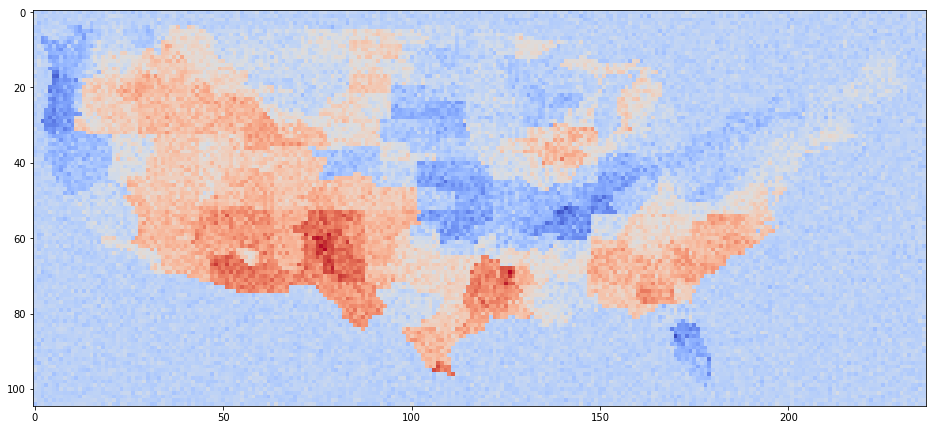

In [39]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16, 12))

prediction_images = []
for i in range(len(prediction_3D)):
    prediction_image = plt.imshow(prediction_3D[i], animated=True, cmap="coolwarm")
    prediction_images.append([prediction_image])

ani = animation.ArtistAnimation(fig, prediction_images, interval=50, blit=True,
                                repeat_delay=1000)

# ani.save("./images/drought_data_timelapse.mp4")

from IPython.display import HTML
HTML(ani.to_jshtml())

Adding epochs seems to have helped the model generate predictions that more accurately reflect the actual fluctuation of drought conditions. The model is not especially accurate at predicting when droughts will spring up, but it does tend to accurately predict the regions in which droughts are most common. I'll try changing the X variable to include more past points in time.